In [4]:
import numpy as np 
import pandas as pd 

In [1]:
import pickle

In [2]:
with open ('scraped_car_list.p', 'rb') as fp:
    itemlist = pickle.load(fp)

In [38]:
import re 
re.findall(r"^\W",itemlist[0].text)
msrp = re.compile('<div>(.*?)</div>', re.DOTALL |  re.IGNORECASE).findall(itemlist[0].text)
msrp[1]

'$72,520 - $82,305'

In [18]:
itemlist[0].text

'<!DOCTYPE html>\n<!-- 1.2.360,N:P,V:P,E:P21 -->\n\n<html lang="en" class="">\n<head><script>var i10cdone =(function(){ function pingBeacon(msg){ var i10cimg = document.createElement(\'script\'); i10cimg.src=\'/i10c@p1/botox/file/nv-loaded.js?status=\'+window.encodeURIComponent(msg); i10cimg.onload = function(){ (document.head || document.documentElement).removeChild(i10cimg) }; i10cimg.onerror = function(){ (document.head || document.documentElement).removeChild(i10cimg) }; ( document.head || document.documentElement).appendChild(i10cimg) }; pingBeacon(\'loaded\'); if(String(document.cookie).indexOf(\'i10c.bdddb=c2-f0103ZLNqAeI3BH6yYOfG7TZlRtCrMwqUo\')>=0) { document.cookie = \'i10c.bdddb=;path=/\';}; var error=\'\'; function errorHandler(e) { if (e && e.error && e.error.stack ) { error=e.error.stack; } else if( e && e.message ) { error = e.message; } else { error = \'unknown\';}} if(window.addEventListener) { window.addEventListener(\'error\',errorHandler, false); } else { if ( windo

In [41]:
price_list = []
def get_price(lst):
    for i in range(0,len(lst)):
        try:
            re.findall(r"^\W",lst[i].text)
            msrp = re.compile('<div>(.*?)</div>', re.DOTALL |  re.IGNORECASE).findall(lst[i].text)
            price_list.append(msrp[1])
        except:
            print('No Price')
    return price_list
get_price(itemlist)
print(price_list)

['$72,520 - $82,305', '$36,550 - $43,690', '<button class="btn border-0 p-0" tabindex="0" data-tracking-id="core_page_open_photoflipper" data-refresh-zone="adhesion"><span class="sr-only">View Photos</span><img src="https://media.ed.edmunds-media.com/lexus/rx-450h/2018/evox/2018_lexus_rx-450h_4dr-suv_f-sport_tds2_evox_1_500.jpg" alt="2019 Lexus RX 450h" class="w-100"/><i class="icon-camera2 rounded text-primary-darker p-0_5 btn btn-lg mt-0_25 ml-0_25"></i></button>', '<button class="btn border-0 p-0" tabindex="0" data-tracking-id="core_page_open_photoflipper" data-refresh-zone="adhesion"><span class="sr-only">View Photos</span><img src="https://media.ed.edmunds-media.com/lexus/rx-350/2018/evox/2018_lexus_rx-350_4dr-suv_base_tds2_evox_4_500.jpg" alt="2019 Lexus RX 350" class="w-100"/><i class="icon-camera2 rounded text-primary-darker p-0_5 btn btn-lg mt-0_25 ml-0_25"></i></button>', '<button class="btn border-0 p-0" tabindex="0" data-tracking-id="core_page_open_photoflipper" data-refres

In [45]:
df = pd.read_html(itemlist[3].text)
df

[Empty DataFrame
 Columns: [Overall, undefined / 5]
 Index: [],   4dr SUV AWD3.5L 6cyl 8A                   Unnamed: 1
 0                    MSRP                      $45,220
 1                     MPG             19 city / 26 hwy
 2                 Seating                      Seats 5
 3            Transmission  8-speed shiftable automatic
 4              Horsepower            295 hp @ 6300 rpm,   4dr SUV3.5L 6cyl 8A                   Unnamed: 1
 0                MSRP                      $43,820
 1                 MPG             20 city / 27 hwy
 2             Seating                      Seats 5
 3        Transmission  8-speed shiftable automatic
 4          Horsepower            295 hp @ 6300 rpm,   F SPORT 4dr SUV AWD3.5L 6cyl 8A                   Unnamed: 1
 0                            MSRP                      $50,870
 1                             MPG             19 city / 26 hwy
 2                         Seating                      Seats 5
 3                    Transmissio

In [46]:
car_df = pd.read_csv('Data/CQA_Advanced.csv')

In [78]:
car_df.describe().T

,count,mean,std,min,25%,50%,75%,max
model_id,73419.0,37309.616557,21883.177604,2.0,18480.5,36904.0,55423.5,76487.0
model_year,73419.0,2000.555946,16.540999,1936.0,1994.0,2006.0,2012.0,2019.0
model_engine_cc,73009.0,2798.990549,1461.278056,211.0,1793.0,2366.0,3600.0,32000.0
model_engine_cyl,72001.0,5.286982,1.795956,0.0,4.0,4.0,6.0,24.0
model_engine_valves_per_cyl,55883.0,3.477587,0.900281,1.0,2.0,4.0,4.0,8.0
model_engine_power_ps,69288.0,196.472116,117.484065,5.0,110.0,170.0,268.0,2000.0
model_engine_power_rpm,51410.0,5400.896713,967.733476,4.0,4800.0,5500.0,6000.0,28000.0
model_engine_torque_nm,67133.0,264.874652,139.213238,18.0,162.0,245.0,340.0,3200.0
model_engine_torque_rpm,49132.0,3386.620024,1043.346910,4.0,2500.0,3500.0,4100.0,9500.0
model_engine_bore_mm,31375.0,84.020698,8.147846,8.4,79.5,84.0,89.0,114.3


In [276]:
newer_car_df = car_df[car_df.model_year > 2017]

In [281]:
newer_car_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 5144 entries, 68275 to 73418
Data columns (total 37 columns):
model_id                       5144 non-null int64
model_make_id                  5144 non-null object
model_name                     5144 non-null object
model_trim                     5144 non-null object
model_year                     5144 non-null int64
model_body                     5144 non-null object
model_engine_position          5144 non-null object
model_engine_cc                5112 non-null float64
model_engine_cyl               5138 non-null float64
model_engine_type              5144 non-null object
model_engine_valves_per_cyl    5052 non-null float64
model_engine_power_ps          5090 non-null float64
model_engine_power_rpm         0 non-null float64
model_engine_torque_nm         5022 non-null float64
model_engine_torque_rpm        0 non-null float64
model_engine_bore_mm           0 non-null float64
model_engine_stroke_mm         0 non-null float64
model_eng

In [287]:
newer_car_df.drop(['model_co2','model_wheelbase_mm','model_height_mm','model_width_mm',
                  'model_length_mm','model_seats','model_0_to_100_kph','model_top_speed_kph',
                  'model_engine_stroke_mm','model_engine_bore_mm','model_engine_torque_rpm',
                  'model_engine_power_rpm'],axis=1,inplace=True)

In [290]:
usa_newer_car_df = newer_car_df[newer_car_df.model_sold_in_us == 1] 

In [293]:
usa_newer_car_df.dropna(inplace=True)

In [297]:
usa_newer_car_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 3230 entries, 68275 to 73412
Data columns (total 25 columns):
model_id                       3230 non-null int64
model_make_id                  3230 non-null object
model_name                     3230 non-null object
model_trim                     3230 non-null object
model_year                     3230 non-null int64
model_body                     3230 non-null object
model_engine_position          3230 non-null object
model_engine_cc                3230 non-null float64
model_engine_cyl               3230 non-null float64
model_engine_type              3230 non-null object
model_engine_valves_per_cyl    3230 non-null float64
model_engine_power_ps          3230 non-null float64
model_engine_torque_nm         3230 non-null float64
model_engine_compression       3230 non-null object
model_engine_fuel              3230 non-null object
model_drive                    3230 non-null object
model_transmission_type        3230 non-null object
m

In [48]:
car_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 73419 entries, 0 to 73418
Data columns (total 37 columns):
model_id                       73419 non-null int64
model_make_id                  73419 non-null object
model_name                     73419 non-null object
model_trim                     60321 non-null object
model_year                     73419 non-null int64
model_body                     57848 non-null object
model_engine_position          72183 non-null object
model_engine_cc                73009 non-null float64
model_engine_cyl               72001 non-null float64
model_engine_type              72294 non-null object
model_engine_valves_per_cyl    55883 non-null float64
model_engine_power_ps          69288 non-null float64
model_engine_power_rpm         51410 non-null float64
model_engine_torque_nm         67133 non-null float64
model_engine_torque_rpm        49132 non-null float64
model_engine_bore_mm           31375 non-null float64
model_engine_stroke_mm         31348 

In [ ]:
model_engine_compression       43554 non-null object
model_engine_fuel              65013 non-null object
model_drive                    71391 non-null object
model_transmission_type        63820 non-null object
model_make_display             73409 non-null object
model_engine_type              72294 non-null object
model_body                     57848 non-null object
model_engine_position          72183 non-null object
model_make_id                  73419 non-null object
model_name                     73419 non-null object
model_trim                     60321 non-null object

In [76]:
len(car_df.model_engine_type.unique())

12

In [75]:
len(car_df.model_engine_fuel.unique())

25

In [73]:
len(car_df.model_drive.unique())

12

In [74]:
len(car_df.model_transmission_type.unique())

36

In [70]:
len(car_df.model_body.unique())

33

In [68]:
len(car_df.model_engine_position.unique())

6

In [72]:
len(car_df.model_make_display.unique())

160

In [77]:
len(car_df.model_engine_compression.unique())

236

In [67]:
len(car_df.model_make_id.unique())

194

In [66]:
len(car_df.model_name.unique())

3129

In [69]:
len(car_df.model_trim.unique())

16465

In [80]:
car_categorical_df = car_df[['model_id','model_make_display','model_engine_compression','model_make_id','model_name','model_trim']]

In [84]:
car_categorical_df.describe()

,model_id
count,73419.000000
mean,37309.616557
std,21883.177604
min,2.000000
25%,18480.500000
50%,36904.000000
75%,55423.500000
max,76487.000000


In [89]:
car_numerical_df = car_df.drop(['model_make_display','model_engine_compression','model_make_id','model_name','model_trim'],axis=1)

In [91]:
car_numerical_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 73419 entries, 0 to 73418
Data columns (total 32 columns):
model_id                       73419 non-null int64
model_year                     73419 non-null int64
model_body                     57848 non-null object
model_engine_position          72183 non-null object
model_engine_cc                73009 non-null float64
model_engine_cyl               72001 non-null float64
model_engine_type              72294 non-null object
model_engine_valves_per_cyl    55883 non-null float64
model_engine_power_ps          69288 non-null float64
model_engine_power_rpm         51410 non-null float64
model_engine_torque_nm         67133 non-null float64
model_engine_torque_rpm        49132 non-null float64
model_engine_bore_mm           31375 non-null float64
model_engine_stroke_mm         31348 non-null float64
model_engine_fuel              65013 non-null object
model_top_speed_kph            19962 non-null float64
model_0_to_100_kph             1839

In [94]:
car_n_dr_na_df = car_numerical_df.drop('model_co2',axis=1)

In [96]:
car_n_dr_na_df = car_n_dr_na_df.dropna()

In [97]:
car_n_dr_na_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 654 entries, 489 to 58337
Data columns (total 31 columns):
model_id                       654 non-null int64
model_year                     654 non-null int64
model_body                     654 non-null object
model_engine_position          654 non-null object
model_engine_cc                654 non-null float64
model_engine_cyl               654 non-null float64
model_engine_type              654 non-null object
model_engine_valves_per_cyl    654 non-null float64
model_engine_power_ps          654 non-null float64
model_engine_power_rpm         654 non-null float64
model_engine_torque_nm         654 non-null float64
model_engine_torque_rpm        654 non-null float64
model_engine_bore_mm           654 non-null float64
model_engine_stroke_mm         654 non-null float64
model_engine_fuel              654 non-null object
model_top_speed_kph            654 non-null float64
model_0_to_100_kph             654 non-null float64
model_drive    

In [102]:
import pandas_profiling
import tqdm

In [104]:
pandas_profiling.ProfileReport(car_n_dr_na_df)

In [105]:
pandas_profiling.ProfileReport(car_numerical_df)

In [114]:
car_df_thre2 = car_numerical_df.drop('model_co2',axis=1)
car_df_thre2 = car_df_thre2.dropna(thresh=2)

In [116]:
car_df_thre2.dropna(subset=['model_0_to_100_kph'],inplace=True)

In [118]:
car_df_thre2.drop(['model_lkm_hwy','model_lkm_city'],axis=1,inplace=True)

In [121]:
pandas_profiling.ProfileReport(car_df_thre2)

In [122]:
car_df_thre2.model_lkm_mixed

127       NaN
261       NaN
383       8.3
387       NaN
389       8.7
391      13.2
392       NaN
395       8.1
399       9.1
404       7.0
406       6.0
407      12.2
409       7.9
410       5.9
411       9.2
414       NaN
415       8.7
421       8.7
424       9.2
425       6.8
429       8.2
430      11.7
434       6.2
435       7.5
436       NaN
437      11.8
441       NaN
442       7.3
443       8.2
445      11.9
         ... 
58260     NaN
58269     NaN
58271     NaN
58273     NaN
58278     NaN
58281     NaN
58282     NaN
58283     NaN
58284     NaN
58285     NaN
58286     NaN
58287     NaN
58288     NaN
58293     NaN
58296     NaN
58297     NaN
58298     NaN
58299     NaN
58300     NaN
58303     NaN
58304     4.9
58319     NaN
58322     NaN
58324     NaN
58331     NaN
58332     NaN
58333     NaN
58335     NaN
58336     NaN
58337     6.5
Name: model_lkm_mixed, Length: 18396, dtype: float64

In [123]:
new_car_df = car_df_thre2.dropna()

In [124]:
new_car_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 7374 entries, 389 to 58337
Data columns (total 29 columns):
model_id                       7374 non-null int64
model_year                     7374 non-null int64
model_body                     7374 non-null object
model_engine_position          7374 non-null object
model_engine_cc                7374 non-null float64
model_engine_cyl               7374 non-null float64
model_engine_type              7374 non-null object
model_engine_valves_per_cyl    7374 non-null float64
model_engine_power_ps          7374 non-null float64
model_engine_power_rpm         7374 non-null float64
model_engine_torque_nm         7374 non-null float64
model_engine_torque_rpm        7374 non-null float64
model_engine_bore_mm           7374 non-null float64
model_engine_stroke_mm         7374 non-null float64
model_engine_fuel              7374 non-null object
model_top_speed_kph            7374 non-null float64
model_0_to_100_kph             7374 non-null float

In [125]:
pandas_profiling.ProfileReport(new_car_df)

In [ ]:
1 km/l = 2.352145833 mpg
for an approximate result, divide the speed value by 1.609
mm to in divide the length value by 25.4
kg to lbs for an approximate result, multiply the mass value by 2.205
l to gal for an approximate result, divide the volume value by 3.785

In [162]:
def lkm_to_mpg(lkm):
    return round(lkm * 2.352145833,1)
new_car_df['average_mpg'] = new_car_df['model_lkm_mixed'].apply(lkm_to_mpg)

In [182]:
def kmh_to_mph(kmh):
    return round(kmh*1.609,1)
new_car_df['0_to_60_mph'] = new_car_df['model_0_to_100_kph']
new_car_df['top_speed_mph'] = new_car_df['model_top_speed_kph']

In [164]:
len(new_car_df[new_car_df.model_sold_in_us == 1])

3871

In [165]:
new_car_df['model_horsepower'] = new_car_df['model_engine_power_ps']

In [187]:
def mm_to_inches(mm):
    return round(mm/25.4,1)
# new_car_df['model_lenght_in'] = new_car_df['model_length_mm'].apply(mm_to_inches)
# new_car_df['model_width_in'] = new_car_df['model_width_mm'].apply(mm_to_inches)
# new_car_df['model_height_in'] = new_car_df['model_height_mm'].apply(mm_to_inches)
# new_car_df['model_wheelbase_in'] = new_car_df['model_wheelbase_mm'].apply(mm_to_inches)
# new_car_df['bore_to_stroke_in'] = new_car_df['model_engine_stroke_mm'].apply(mm_to_inches)
new_car_df['engine_bore_in'] = new_car_df['model_engine_bore_mm'].apply(mm_to_inches)
new_car_df['engine_stroke_in'] = new_car_df['bore_to_stroke_in']

In [168]:
# kg to lbs for an approximate result, multiply the mass value by 2.205
# l to gal for an approximate result, divide the volume value by 3.785
# ft-lb =Nm * 0.73756

In [169]:
def l_to_gal(l):
    return round(l/3.785,1)

In [171]:
new_car_df['fuel_cap_galons'] = new_car_df['model_fuel_cap_l'].apply(l_to_gal)

In [173]:
new_car_df.drop(['model_lkm_mixed','model_0_to_100_kph','model_engine_power_ps','model_length_mm','model_width_mm',
                'model_height_mm','model_wheelbase_mm','model_engine_stroke_mm','model_fuel_cap_l'],axis=1,inplace=True)

In [175]:
def nm_to_ftlbs(nm):
    return round(nm*0.73756,1)
new_car_df['engine_ft_lbs_torque'] = new_car_df['model_engine_torque_nm'].apply(nm_to_ftlbs)

In [189]:
new_car_df.drop('bore_to_stroke_in',axis=1,inplace=True)

In [190]:
new_car_df.head()

,model_id,model_year,model_body,model_engine_position,model_engine_cc,model_engine_cyl,model_engine_type,model_engine_valves_per_cyl,model_engine_power_rpm,model_engine_torque_rpm,...,model_horsepower,model_lenght_in,model_width_in,model_height_in,model_wheelbase_in,fuel_cap_galons,engine_ft_lbs_torque,top_speed_mph,engine_bore_in,engine_stroke_in
389,396,2007,Coupe,Front,1969.0,4.0,in-line,4.0,6400.0,3250.0,...,165.0,177.2,69.7,53.9,102.4,16.6,151.9,216.0,3.3,3.6
391,398,2009,Roadster,Front,3179.0,6.0,V,4.0,6200.0,4800.0,...,240.0,169.7,70.1,52.0,100.4,18.5,213.2,242.0,3.7,3.1
399,406,2004,Station Wagon,Front,1910.0,4.0,in-line,4.0,6400.0,3250.0,...,166.0,175.2,68.9,55.1,102.4,16.6,151.9,220.0,3.3,3.6
404,411,2009,Station Wagon,Front,2387.0,5.0,in-line,4.0,4000.0,2000.0,...,200.0,183.9,72.4,57.5,106.7,18.5,295.0,226.0,3.2,3.6
406,413,2005,Sedan,Front,1970.0,4.0,in-line,4.0,4000.0,2000.0,...,140.0,174.8,68.9,55.1,102.4,16.6,228.6,209.0,3.2,3.6


In [191]:
american_new_car_df = new_car_df[new_car_df.model_sold_in_us == 1]

In [192]:
american_new_car_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 3871 entries, 1382 to 58337
Data columns (total 29 columns):
model_id                       3871 non-null int64
model_year                     3871 non-null int64
model_body                     3871 non-null object
model_engine_position          3871 non-null object
model_engine_cc                3871 non-null float64
model_engine_cyl               3871 non-null float64
model_engine_type              3871 non-null object
model_engine_valves_per_cyl    3871 non-null float64
model_engine_power_rpm         3871 non-null float64
model_engine_torque_rpm        3871 non-null float64
model_engine_fuel              3871 non-null object
model_drive                    3871 non-null object
model_transmission_type        3871 non-null object
model_seats                    3871 non-null float64
model_doors                    3871 non-null float64
model_weight_kg                3871 non-null float64
model_sold_in_us               3871 non-null float6

In [199]:
american_new_car_df.drop('model_engine_cc',axis=1,inplace=True)

In [197]:
american_new_car_df.set_index('model_id',inplace=True)

In [266]:
# pandas_profiling.ProfileReport(american_new_car_df)

In [210]:
american_new_car_df = pd.get_dummies(american_new_car_df,columns=['model_body','model_engine_position','model_engine_type','model_engine_fuel',
                                  'model_drive','model_transmission_type'],drop_first=True)

In [211]:
american_new_car_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 3871 entries, 1401 to 58708
Data columns (total 45 columns):
model_year                                      3871 non-null int64
model_engine_cyl                                3871 non-null float64
model_engine_valves_per_cyl                     3871 non-null float64
model_engine_power_rpm                          3871 non-null float64
model_engine_torque_rpm                         3871 non-null float64
model_seats                                     3871 non-null float64
model_doors                                     3871 non-null float64
model_weight_kg                                 3871 non-null float64
average_mpg                                     3871 non-null float64
0_to_60_mph                                     3871 non-null float64
model_horsepower                                3871 non-null float64
model_lenght_in                                 3871 non-null float64
model_width_in                                  387

In [ ]:
model_engine_valves_per_cy, model_doors

In [214]:
american_new_car_df.head()

,model_year,model_engine_cyl,model_engine_valves_per_cyl,model_engine_power_rpm,model_engine_torque_rpm,model_seats,model_doors,model_weight_kg,average_mpg,0_to_60_mph,...,model_engine_fuel_Gasoline,model_engine_fuel_Gasoline - Premium,model_engine_fuel_Gasoline / Electric Hybrid,model_drive_AWD,model_drive_Front,model_drive_Rear,model_transmission_type_6-speed manual,model_transmission_type_Automatic,model_transmission_type_CVT,model_transmission_type_Manual
model_id,,,,,,,,,,,,,,,,,,,,,
1401,2009,8.0,4.0,5500.0,4250.0,5.0,4.0,1990.0,30.3,5.0,...,0,1,0,0,0,1,0,1,0,0
1403,2008,6.0,4.0,6300.0,4800.0,5.0,2.0,1452.0,25.9,5.4,...,0,1,0,0,0,1,0,0,0,1
1407,2008,8.0,4.0,5500.0,4250.0,5.0,4.0,1720.0,28.9,4.7,...,0,1,0,0,0,1,0,1,0,0
1409,2008,8.0,4.0,5500.0,4250.0,5.0,4.0,1960.0,30.1,4.9,...,0,1,0,0,0,1,0,1,0,0
1411,2007,8.0,4.0,5500.0,4250.0,5.0,4.0,1722.0,28.9,4.7,...,0,1,0,0,0,1,0,1,0,0


In [202]:
car_categorical_df.set_index('model_id',inplace=True)

In [216]:
joined_df = american_new_car_df.join(car_categorical_df,how='left',)

In [264]:
joined_df.sample(2)

,model_year,model_engine_cyl,model_engine_valves_per_cyl,model_engine_power_rpm,model_engine_torque_rpm,model_seats,model_doors,model_weight_kg,average_mpg,0_to_60_mph,...,model_drive_Rear,model_transmission_type_6-speed manual,model_transmission_type_Automatic,model_transmission_type_CVT,model_transmission_type_Manual,model_make_display,model_engine_compression,model_make_id,model_name,model_trim
model_id,,,,,,,,,,,,,,,,,,,,,
56832,2005,6.0,4.0,6800.0,4100.0,5.0,4.0,1673.0,24.7,7.6,...,1,0,1,0,0,Jaguar,11.0:1,jaguar,S-Type,3.0 V6 Sport Automatic
8322,2009,6.0,2.0,5100.0,4000.0,6.0,5.0,2165.0,29.6,14.2,...,0,0,1,0,0,Chrysler,NaN,chrysler,Grand Voyager,LTD 3.3 V6 AWD


In [265]:
joined_df.query('8322')

model_year                                                2009
model_engine_cyl                                             6
model_engine_valves_per_cyl                                  2
model_engine_power_rpm                                    5100
model_engine_torque_rpm                                   4000
model_seats                                                  6
model_doors                                                  5
model_weight_kg                                           2165
average_mpg                                               29.6
0_to_60_mph                                               14.2
model_horsepower                                           174
model_lenght_in                                          200.8
model_width_in                                            78.7
model_height_in                                           69.3
model_wheelbase_in                                       119.7
fuel_cap_galons                                        

In [269]:
joined_df.model_year.max()

2013

In [223]:
from sklearn.preprocessing import StandardScaler as SS
#(copy=True, with_mean=True, with_std=True)
ss = SS()
ss_df = ss.fit_transform(american_new_car_df)

In [236]:
from sklearn.decomposition import PCA
pca = PCA(n_components=20)
pca_df = pca.fit_transform(ss_df)
# pca.n_components_
# pca = decomposition.PCA(n_components=10)
# X_pca = pca.fit_transform(X_centered)

In [239]:
def scree_plot(ax, pca, n_components_to_plot=20, title=None):
    """Make a scree plot showing the variance explained (i.e. variance
    of the projections) for the principal components in a fit sklearn
    PCA object.
    
    Parameters
    ----------
    ax: matplotlib.axis object
      The axis to make the scree plot on.
      
    pca: sklearn.decomposition.PCA object.
      A fit PCA object.
      
    n_components_to_plot: int
      The number of principal components to display in the scree plot.
      
    title: str
      A title for the scree plot.
    """
    num_components = pca.n_components_
    ind = np.arange(num_components)
    vals = pca.explained_variance_ratio_
    ax.plot(ind, vals, color='blue')
    ax.scatter(ind, vals, color='blue', s=50)

    for i in range(num_components):
        ax.annotate(r"{:2.2f}%".format(vals[i]), 
        (ind[i]+0.2, vals[i]+0.005), 
        va="bottom", 
        ha="center", 
        fontsize=12)

    ax.set_xticklabels(ind, fontsize=12)
    ax.set_ylim(0, max(vals) + 0.05)
    ax.set_xlim(0 - 0.45, n_components_to_plot + 0.45)
    ax.set_xlabel("Principal Component", fontsize=12)
    ax.set_ylabel("Variance Explained (%)", fontsize=12)
    if title is not None:
        ax.set_title(title, fontsize=16)

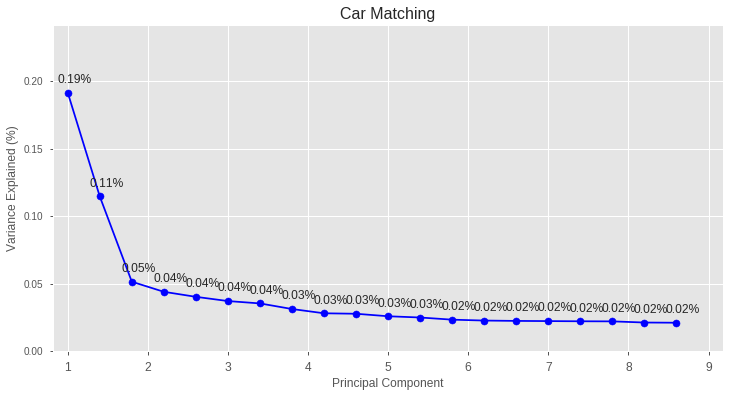

In [241]:
import matplotlib.pyplot as plt
plt.style.use('ggplot')
fig, ax = plt.subplots(figsize=(12,6))
scree_plot(ax, pca, n_components_to_plot=20, title='Car Matching')

In [244]:
from sklearn.decomposition import NMF
nmf = NMF(n_components=20, tol=0.0001, max_iter=200, random_state=42, alpha=0.1, verbose=1)

In [246]:
# nmf = NMF_sklearn(n_components=7, max_iter=100, random_state=12345, alpha=0.0)
W = nmf.fit_transform(american_new_car_df)


violation: 1.0
violation: 0.7478924202133689
violation: 0.4713969364970418
violation: 0.2661796040290913
violation: 0.18222893927865727
violation: 0.13455220675128174
violation: 0.10284691139353772
violation: 0.08179420935374247
violation: 0.0671213950099257
violation: 0.056176689113262304
violation: 0.04782482942295173
violation: 0.04091289872920511
violation: 0.035552836953181066
violation: 0.031246063628529833
violation: 0.0277278301519059
violation: 0.024860479337279813
violation: 0.022636587083012662
violation: 0.02112855659123883
violation: 0.020695936826988524
violation: 0.02043587821050809
violation: 0.018215630501179466
violation: 0.016522575026441028
violation: 0.015475806311073727
violation: 0.014616267256858965
violation: 0.013871420874857507
violation: 0.013198564743990742
violation: 0.012610335734923619
violation: 0.012041189945566324
violation: 0.011496550714664051
violation: 0.010945487721119107
violation: 0.0104001421778306
violation: 0.009889212578724545
violation: 0.

In [248]:
H = nmf.components_
H

array([[1.52261909e+02, 2.02786118e-01, 2.32762211e-01, 5.39864106e+02,
        2.32329701e+02, 1.47251786e-01, 8.26653450e-02, 9.63301218e+01,
        7.95561776e-01, 2.19303306e-01, 4.75904713e+00, 9.80787524e+00,
        3.70149133e+00, 3.50744519e+00, 6.15097178e+00, 4.81469070e-01,
        4.37417398e+00, 1.21365036e+01, 2.23415128e-01, 2.27777134e-01,
        0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
        0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
        0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
        0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
        4.18121676e-02, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
        0.00000000e+00, 0.00000000e+00, 4.37498169e-03, 0.00000000e+00,
        1.52513356e-02],
       [9.93306227e-01, 1.49230646e-02, 0.00000000e+00, 2.80475820e-01,
        3.02752250e+02, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
        3.23969106e-01, 3.53744344e-03,

In [249]:
print('reconstruction error:', nmf.reconstruction_err_)


reconstruction error: 257.74842956170045
